In [1]:
# Load Pandas
import pandas as pd
# Load Pyplot
import matplotlib.pyplot as plt
# Load Seaborn
import seaborn as sns

# Load Dataset from Local Directory
dataset = pd.read_csv('C:\IA\dataset.csv')
dataset_naoclassificado = pd.read_csv('C:\IA\dataset_naoclassificado.csv')

In [2]:
# Load First 5 rows of Dataset
dataset.head()

,id_registo,temperatura,humidade_relativa,luz,CO2,humidade_absoluta,ocupacao
0,20019,20.513802,29.911067,1012.993709,783.551679,0.004371,0
1,29077,21.347758,18.760759,165.049937,477.166606,0.002899,0
2,17474,20.712988,33.721442,0.000000,517.784597,0.004799,0
3,26163,20.138632,34.154604,149.785610,1515.136696,0.004924,0
4,16665,22.761815,30.479519,608.948933,1012.253115,0.004944,1


In [3]:
# Examine Dataset
dataset.describe()

,id_registo,temperatura,humidade_relativa,luz,CO2,humidade_absoluta,ocupacao
count,12000.000000,11998.000000,12000.000000,11996.000000,12000.000000,12000.000000,12000.000000
mean,20283.311000,20.894615,27.638579,164.023422,689.591856,0.004226,0.233333
std,5971.257891,1.198419,4.998065,209.922005,308.743787,0.000812,0.422970
min,10001.000000,18.162697,15.841830,0.000000,372.165161,0.002208,0.000000
25%,15102.000000,20.031394,24.401772,0.000000,471.709507,0.003659,0.000000
50%,20322.500000,20.765391,27.377525,94.344331,567.044924,0.004255,0.000000
75%,25454.250000,21.595745,31.282651,249.876543,810.097794,0.004815,0.000000
max,30560.000000,25.224256,40.192761,1608.948181,2092.803510,0.006893,1.000000


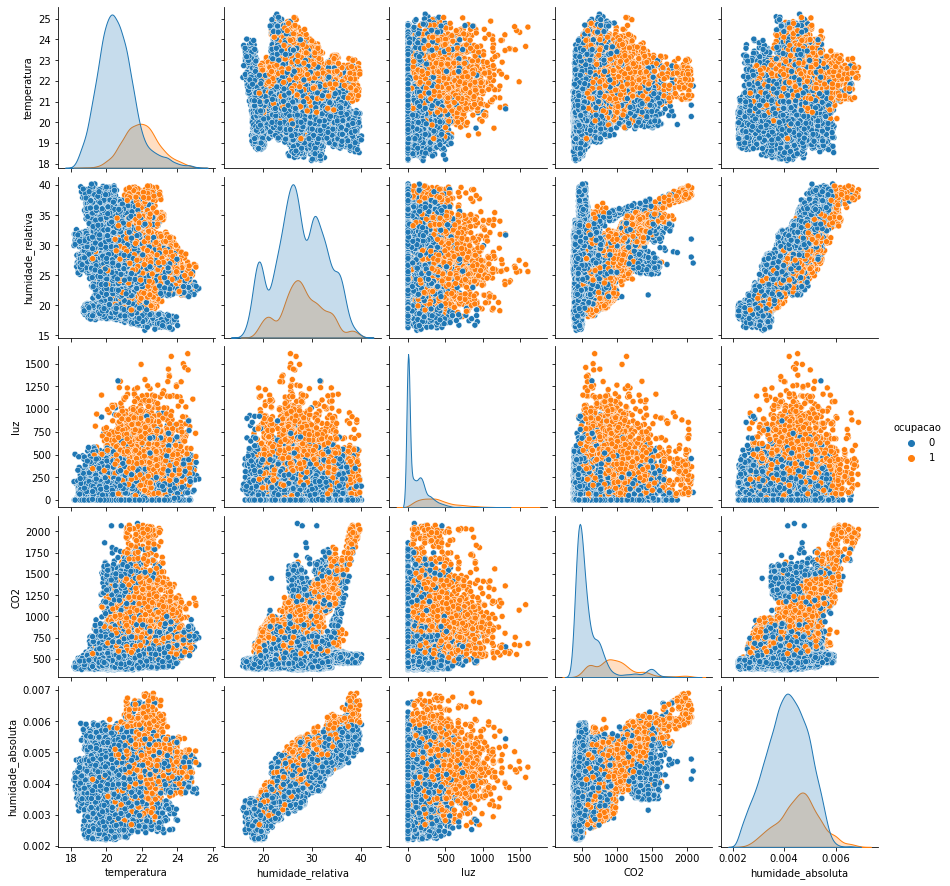

In [4]:
# Fill NaNs with mean values
dataset.temperatura = dataset.temperatura.fillna(dataset.temperatura.mean())
dataset.luz = dataset.luz.fillna(dataset.luz.mean())

# Drop id_registo from Dataset
dataset = dataset.drop('id_registo', axis = 1)
# Drop id_registo and humidade_absoluta from Dataset_NaoClassificado
dataset_naoclassificado = dataset_naoclassificado.drop(['id_registo', 'humidade_absoluta'], axis = 1)

# Show the relation between every variable
sns.pairplot(dataset, hue = 'ocupacao')
plt.show()

In [5]:
# Define Features (X) and Target (y)
X = dataset.drop(['ocupacao', 'humidade_absoluta'], axis = 1)
y = dataset['ocupacao']

In [6]:
# Load Train Test Split
from sklearn.model_selection import train_test_split

# Train and Test Split of Dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 1)

In [7]:
# Load Scaler
from sklearn.preprocessing import StandardScaler

# Scale all Features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Scale dataset_naoclassificado
scaled_naoclassificado = scaler.transform(dataset_naoclassificado)

In [8]:
# Load Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier

# Execute Random Forest Classifier Algorithm
clf = RandomForestClassifier(n_estimators = 1000, random_state = 1234)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

# Predict Dataset_NaoClassificado
classificacao_estimada = clf.predict(scaled_naoclassificado)
# Create a DataFrame with Predictions Results
classificacao_estimada_df = pd.DataFrame(classificacao_estimada)
# Create Final DataFrame with id_registo and ocupacao
dataset_naoclassificado = pd.read_csv('C:\IA\dataset_naoclassificado.csv')
dataset_naoclassificado = dataset_naoclassificado.drop(['temperatura', 'luz', 'CO2', 'humidade_relativa', 'humidade_absoluta'], axis = 1)
dataset_naoclassificado['ocupacao'] = classificacao_estimada_df
# Export DataFrame to CSV File
dataset_naoclassificado.to_csv('C:\IA\classificacao_estimada.csv', index = None)

In [9]:
# Load Metrics
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

# Print differents metrics of evaluation
print(classification_report(y_test,y_pred))
print("\nAccuracy Score: ", accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97      2315
           1       0.88      0.89      0.89       685

    accuracy                           0.95      3000
   macro avg       0.93      0.93      0.93      3000
weighted avg       0.95      0.95      0.95      3000


Accuracy Score:  0.9493333333333334


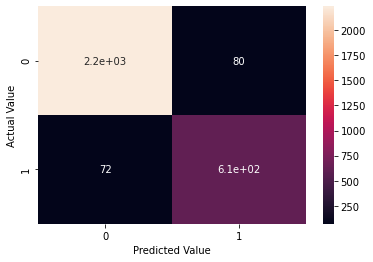

In [10]:
# Creating a heat map for Results
confusion_matrix = pd.crosstab(y_test, y_pred, rownames=['Actual Value'], colnames=['Predicted Value'])
sns.heatmap(confusion_matrix, annot=True)
plt.show()

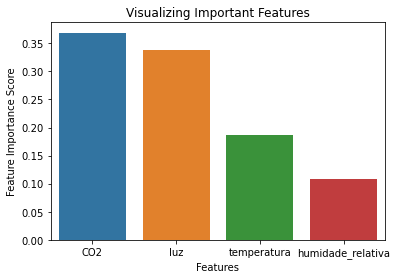

In [11]:
# Checking Importance of Features
feature_importances_df = pd.DataFrame(
    {"feature": list(X.columns), "importance": clf.feature_importances_}
).sort_values("importance", ascending=False)

# Creating a bar plot for Importance of Features
sns.barplot(x=feature_importances_df.feature, y=feature_importances_df.importance)

plt.xlabel("Features")
plt.ylabel("Feature Importance Score")
plt.title("Visualizing Important Features")

plt.show()

In [12]:
# Load Metrics
#from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

# Load Random Forest Classifier
#from sklearn.ensemble import RandomForestClassifier

# Execute Random Forest Classifier Algorithm
#rf = RandomForestClassifier(random_state = 1234)

# Load RandomizedSearchCV
#from sklearn.model_selection import RandomizedSearchCV

# Number of trees in random forest
#n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
#max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
#max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
#max_depth.append(None)
# Minimum number of samples required to split a node
#min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
#min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
#bootstrap = [True, False]

# Create the random grid
#random_grid = {'n_estimators': n_estimators,
               #'max_features': max_features,
               #'max_depth': max_depth,
               #'min_samples_split': min_samples_split,
               #'min_samples_leaf': min_samples_leaf,
               #'bootstrap': bootstrap}

# Random Search of Parameters
#rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 100, random_state = 1234, cv = 3, verbose=2, n_jobs = -1)

# Fit the random search model
#rf_random.fit(X_train, y_train)

#rf_random.best_params_

#best_random = rf_random.best_estimator_

#best_random.score(X_test, y_test)"""